# RADICAL RAVENS

## SAFIA FAIZ
## SUNYAH FAISAL
## SYED MUHAMMAD MUBASHIR RIZVI

# Importing the libraries

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

from sklearn.impute import SimpleImputer
from sklearn.preprocessing import LabelEncoder, StandardScaler, OneHotEncoder, MinMaxScaler
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, make_scorer
from sklearn.compose import TransformedTargetRegressor
from sklearn.preprocessing import PowerTransformer

# Exploratory Data Analysis 

## Exploring the dataset structure 

### First few rows

In [2]:
df = pd.read_csv("pakistanproperty.csv", index_col = 'ID')
df.head()

,property_type,price,location,city,province_name,latitude,longitude,baths,area,purpose,bedrooms,agence,agent,area.1,area unit,month,day,year
ID,,,,,,,,,,,,,,,,,,
0,House,7000000,DHA Defence,Islamabad,Islamabad Capital,33.492591,73.301339,3,8 Marla,For Sale,3,Easy Property,Muhammad Junaid Ceo Muhammad Shahid Director,8.0,Marla,7,10,2019
1,Flat,7800000,E-11,Islamabad,Islamabad Capital,33.698244,72.984238,2,6.2 Marla,For Sale,2,Ettemad Enterprises,Balqiaz Marwat,6.2,Marla,5,5,2019
2,House,50000000,DHA Defence,Islamabad,Islamabad Capital,33.540894,73.095732,7,1 Kanal,For Sale,7,Easy Property,Muhammad Junaid Ceo Muhammad Shahid Director,1.0,Kanal,10,19,2018
3,Penthouse,40000000,F-11,Islamabad,Islamabad Capital,33.679211,72.988787,5,1 Kanal,For Sale,5,Crown Associate,Abrar Ahmed,1.0,Kanal,6,27,2019
4,Flat,35000000,Diplomatic Enclave,Islamabad,Islamabad Capital,33.728873,73.119628,3,7.1 Marla,For Sale,3,Al Sahar Estate,Zahid H. Usmani,7.1,Marla,6,3,2019


### Summary statistics

In [3]:
df.describe()

,price,latitude,longitude,baths,bedrooms,area.1,month,day,year
count,7.215600e+04,72156.000000,72156.000000,72156.000000,72156.000000,72156.000000,72156.000000,72156.000000,72156.000000
mean,2.208442e+07,29.741504,71.186678,3.044182,3.281390,5.848280,5.581019,14.574186,2018.982635
std,4.256980e+07,3.804829,3.161406,2.297894,1.926559,4.383113,1.378661,9.542614,0.130629
min,0.000000e+00,24.749425,66.863657,0.000000,0.000000,0.000000,1.000000,1.000000,2018.000000
25%,6.287500e+05,24.937425,67.122366,1.000000,2.000000,2.900000,5.000000,5.000000,2019.000000
50%,1.050000e+07,31.452023,73.050990,3.000000,3.000000,5.000000,6.000000,16.000000,2019.000000
75%,2.400000e+07,33.550096,74.170847,5.000000,5.000000,8.400000,6.000000,25.000000,2019.000000
max,2.000000e+09,73.184088,74.564727,13.000000,18.000000,416.000000,12.000000,30.000000,2019.000000


### Summary of the data

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 72156 entries, 0 to 72155
Data columns (total 18 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   property_type  72156 non-null  object 
 1   price          72156 non-null  int64  
 2   location       72156 non-null  object 
 3   city           72156 non-null  object 
 4   province_name  72156 non-null  object 
 5   latitude       72156 non-null  float64
 6   longitude      72156 non-null  float64
 7   baths          72156 non-null  int64  
 8   area           72156 non-null  object 
 9   purpose        72156 non-null  object 
 10  bedrooms       72156 non-null  int64  
 11  agence         72156 non-null  object 
 12  agent          72156 non-null  object 
 13  area.1         72156 non-null  float64
 14  area unit      72156 non-null  object 
 15  month          72156 non-null  int64  
 16  day            72156 non-null  int64  
 17  year           72156 non-null  int64  
dtypes: flo

### Data types of the columns

In [5]:
df.dtypes

property_type     object
price              int64
location          object
city              object
province_name     object
latitude         float64
longitude        float64
baths              int64
area              object
purpose           object
bedrooms           int64
agence            object
agent             object
area.1           float64
area unit         object
month              int64
day                int64
year               int64
dtype: object

### Unique values in the data

In [6]:
df.nunique()

property_type       7
price            1448
location          981
city                5
province_name       3
latitude         3561
longitude        3730
baths              14
area              289
purpose             2
bedrooms           18
agence           5195
agent            8891
area.1            216
area unit           2
month              12
day                29
year                2
dtype: int64

### Finding correlation among the variables

C:\Users\Mehdi\AppData\Local\Temp\ipykernel_27560\219827144.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr = df.corr()


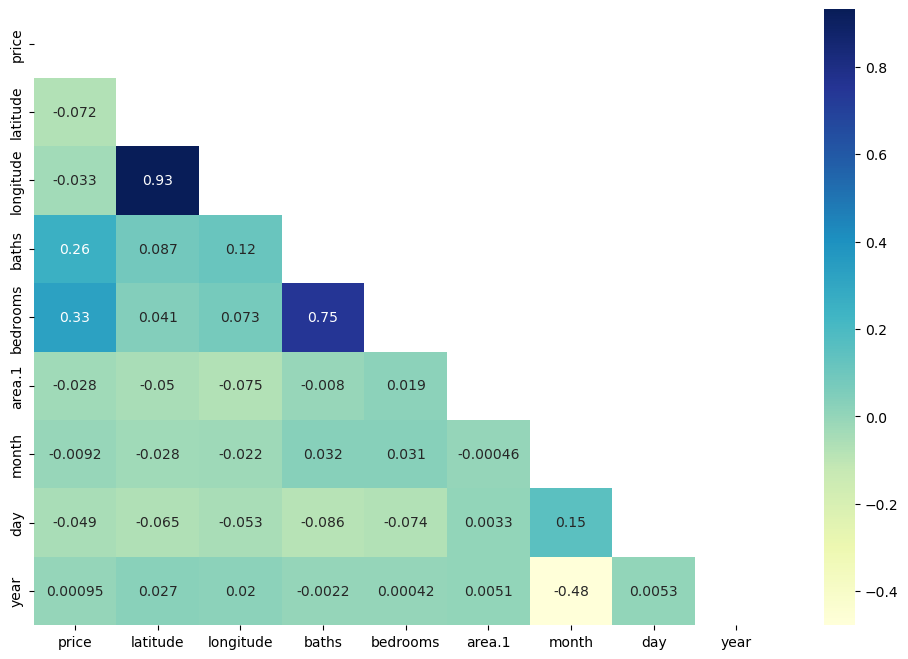

In [7]:
# find correlation using corr()
corr = df.corr()

# get the lower portion of the matrix to avoid redundancy
matrix = np.triu(corr)

# build the heatmap
plt.figure(figsize = (12, 8))
sns.heatmap(corr, annot = True, cmap = "YlGnBu", mask = matrix)
plt.show();

From the following plot, we can see:
1. `longitude` and `latitude` have high correlation (0.93)
2. `bedrooms` and `baths` have moderate correlation (0.75)
But still, we won't drop them as it is relevant to the dataset and doesn't necessarily indicate multi-collinearity.

### Distribution of variables

In [8]:
col=list(df.columns)
for i in col:
    print(f"---{i}---")
    print(df[i].value_counts())
    print()

---property_type---
House            45689
Flat             17583
Upper Portion     4933
Lower Portion     3268
Farm House         342
Penthouse          181
Room               160
Name: property_type, dtype: int64

---price---
15000000     1122
35000        1071
12500000      966
6500000       932
12000000      887
             ... 
35900000        1
8764000         1
39800000        1
3165000         1
153000000       1
Name: price, Length: 1448, dtype: int64

---location---
DHA Defence                     11790
Bahria Town Rawalpindi           4029
Bahria Town Karachi              3519
Gulistan-e-Jauhar                2615
Gulshan-e-Iqbal Town             1981
                                ...  
New Katarian                        1
Shadipura                           1
Islamabad, Islamabad Capital        1
Jamal Homes                         1
Britto Road                         1
Name: location, Length: 981, dtype: int64

---city---
Karachi       26687
Lahore        18225
Islama

## Data preprocessing and cleaning

### Having a common and standardized unit for area

* In the dataset, there are two units given for dataset, but for more efficiency of the model and better performance, it is better if the units are consistent.
* To solve this, both Marla and Kanal units will be converted to sq.ft units which are very common and is a standard unit for area in many places.
* 1 Marla = 272.51 sq.ft
* 1 Kanal = 5445 sq.ft

In [9]:
def consistent_units(row):
    unit = row['area unit']
    if unit.lower() == 'marla':
        row['area.1'] = row['area.1'] * 272.51
    if unit.lower() == 'kanal':
        row['area.1'] = row['area.1'] * 5445
    return row

In [10]:
df = df.apply(consistent_units, axis = 1)

In [11]:
df.head()

,property_type,price,location,city,province_name,latitude,longitude,baths,area,purpose,bedrooms,agence,agent,area.1,area unit,month,day,year
ID,,,,,,,,,,,,,,,,,,
0,House,7000000,DHA Defence,Islamabad,Islamabad Capital,33.492591,73.301339,3,8 Marla,For Sale,3,Easy Property,Muhammad Junaid Ceo Muhammad Shahid Director,2180.080,Marla,7,10,2019
1,Flat,7800000,E-11,Islamabad,Islamabad Capital,33.698244,72.984238,2,6.2 Marla,For Sale,2,Ettemad Enterprises,Balqiaz Marwat,1689.562,Marla,5,5,2019
2,House,50000000,DHA Defence,Islamabad,Islamabad Capital,33.540894,73.095732,7,1 Kanal,For Sale,7,Easy Property,Muhammad Junaid Ceo Muhammad Shahid Director,5445.000,Kanal,10,19,2018
3,Penthouse,40000000,F-11,Islamabad,Islamabad Capital,33.679211,72.988787,5,1 Kanal,For Sale,5,Crown Associate,Abrar Ahmed,5445.000,Kanal,6,27,2019
4,Flat,35000000,Diplomatic Enclave,Islamabad,Islamabad Capital,33.728873,73.119628,3,7.1 Marla,For Sale,3,Al Sahar Estate,Zahid H. Usmani,1934.821,Marla,6,3,2019


### Dropping irrelevant and redundant attributes

* Some columns are irrelevant and won't be needed, such as:
    1. Month
    2. Day
    3. Year
    4. Area
    5. Area unit

<br>

* When training a model, the following columns will also be dropped as they don't contribute to predicting the price:
    1. Agence
    2. Agent

In [12]:
df.drop(columns = [ 'area', 'area unit'], axis = 1, inplace = True)
#'month', 'day', 'year', will use these only for visualization will drop for modelling as it is 
# not relevant to our price prediction

In [13]:
df.head()

,property_type,price,location,city,province_name,latitude,longitude,baths,purpose,bedrooms,agence,agent,area.1,month,day,year
ID,,,,,,,,,,,,,,,,
0,House,7000000,DHA Defence,Islamabad,Islamabad Capital,33.492591,73.301339,3,For Sale,3,Easy Property,Muhammad Junaid Ceo Muhammad Shahid Director,2180.080,7,10,2019
1,Flat,7800000,E-11,Islamabad,Islamabad Capital,33.698244,72.984238,2,For Sale,2,Ettemad Enterprises,Balqiaz Marwat,1689.562,5,5,2019
2,House,50000000,DHA Defence,Islamabad,Islamabad Capital,33.540894,73.095732,7,For Sale,7,Easy Property,Muhammad Junaid Ceo Muhammad Shahid Director,5445.000,10,19,2018
3,Penthouse,40000000,F-11,Islamabad,Islamabad Capital,33.679211,72.988787,5,For Sale,5,Crown Associate,Abrar Ahmed,5445.000,6,27,2019
4,Flat,35000000,Diplomatic Enclave,Islamabad,Islamabad Capital,33.728873,73.119628,3,For Sale,3,Al Sahar Estate,Zahid H. Usmani,1934.821,6,3,2019


### Renaming columns for clarity

In [14]:
df.columns

Index(['property_type', 'price', 'location', 'city', 'province_name',
       'latitude', 'longitude', 'baths', 'purpose', 'bedrooms', 'agence',
       'agent', 'area.1', 'month', 'day', 'year'],
      dtype='object')

In [15]:
df.rename(columns={'area.1': 'area (sq.ft)', 'province_name': 'province'}, inplace = True)

In [16]:
df.columns

Index(['property_type', 'price', 'location', 'city', 'province', 'latitude',
       'longitude', 'baths', 'purpose', 'bedrooms', 'agence', 'agent',
       'area (sq.ft)', 'month', 'day', 'year'],
      dtype='object')

### Dropping duplicated rows

In [17]:
# checking if there are duplicated rows using the df.duplicated() function

df[df.duplicated(keep = 'first')]       # keep = 'first' does not mark the first occurrence as duplicate

,property_type,price,location,city,province,latitude,longitude,baths,purpose,bedrooms,agence,agent,area (sq.ft),month,day,year
ID,,,,,,,,,,,,,,,,
165,House,23000000,Askari,Lahore,Punjab,31.533270,74.413580,5,For Sale,4,Forces Properties,Khalid Saeed Khan,2725.100,6,18,2019
190,House,22000000,Askari,Lahore,Punjab,31.537458,74.413323,5,For Sale,4,Forces Properties,Khalid Saeed Khan,2725.100,6,18,2019
447,House,32500000,State Life Housing Society,Lahore,Punjab,31.446824,74.404736,6,For Sale,5,Harum Real Estate & Builders,Sharafat Ali,5445.000,6,30,2019
645,Flat,140000,F-8,Islamabad,Islamabad Capital,33.707982,73.050476,0,For Rent,1,Shapers Builders & Real Estate,Faisal Shahzad,1389.801,6,27,2019
701,Upper Portion,25000,Bahria Town Rawalpindi,Rawalpindi,Punjab,33.482319,73.095295,3,For Rent,3,Madni Estate,Mr Asad,2725.100,7,8,2019
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72021,Flat,23000,G-11,Islamabad,Islamabad Capital,33.675604,73.000367,2,For Rent,2,Niazi Real Estate,"Salik, Ibrahim",1090.040,7,1,2019
72026,House,90000,G-13,Islamabad,Islamabad Capital,33.650065,72.963681,5,For Rent,5,Khans Real Estate & Builders,Ahtsham Khan,2725.100,6,30,2019
72033,House,48000,G-13,Islamabad,Islamabad Capital,33.650065,72.963681,4,For Rent,4,Khans Real Estate & Builders,Ahtsham Khan,1090.040,6,30,2019


In [18]:
# get the original shape of the dataframe
original_shape = df.shape

# drop the duplicated rows
df.drop_duplicates(keep = "first", inplace = True)

# get the new shape of the dataframe
new_shape = df.shape

print(f"Shape of dataframe before dropping duplicates: {original_shape}")
print(f"Shape of dataframe after dropping duplicates: {new_shape}")
print(f"Total rows dropped: {original_shape[0] - new_shape[0]}")

Shape of dataframe before dropping duplicates: (72156, 16)
Shape of dataframe after dropping duplicates: (65627, 16)
Total rows dropped: 6529


### Finding null values of the columns

In [19]:
df.isna().sum()

property_type    0
price            0
location         0
city             0
province         0
latitude         0
longitude        0
baths            0
purpose          0
bedrooms         0
agence           0
agent            0
area (sq.ft)     0
month            0
day              0
year             0
dtype: int64

In [20]:
df[df['price'] == 0]

,property_type,price,location,city,province,latitude,longitude,baths,purpose,bedrooms,agence,agent,area (sq.ft),month,day,year
ID,,,,,,,,,,,,,,,,
53297,Farm House,0,Gadap Road,Karachi,Sindh,25.053956,67.253365,0,For Sale,0,Bin Anus Real Estate,M. Humayun Jokhio,43560.0,6,21,2019


Even though there are no missing values, there are many rows where it shows `bathrooms = 0`, `bedrooms = 0`, and one row where it shows `price = 0`. In real life, it is highly unlikely for a property to have zero bathrooms or zero bedrooms. 

* Can simply drop the one row where `price = 0` as it will not cause loss of information.
* Can not drop rows where `bathrooms = 0` or `bedrooms = 0` because there are a lot of these rows. Will replace the `0` values with `NaN` to help in imputation.

In [21]:
df['baths'] = df['baths'].replace(0, np.nan)
df['bedrooms'] = df['bedrooms'].replace(0, np.nan)
df.isna().sum()

property_type        0
price                0
location             0
city                 0
province             0
latitude             0
longitude            0
baths            15060
purpose              0
bedrooms          7418
agence               0
agent                0
area (sq.ft)         0
month                0
day                  0
year                 0
dtype: int64

In [22]:
property_types = df['property_type'].unique()
prop_groups = [df[df['property_type'] == prop_type] for prop_type in property_types]
prop_groups

[      property_type      price             location       city  \
 ID                                                               
 0             House    7000000          DHA Defence  Islamabad   
 2             House   50000000          DHA Defence  Islamabad   
 8             House   19000000          DHA Defence  Islamabad   
 9             House   80000000          DHA Defence  Islamabad   
 13            House  100000000                  F-6  Islamabad   
 ...             ...        ...                  ...        ...   
 72143         House   77500000      North Nazimabad    Karachi   
 72144         House   67500000      North Nazimabad    Karachi   
 72145         House   26500000      North Nazimabad    Karachi   
 72147         House    8500000  Bahria Town Karachi    Karachi   
 72152         House      30000  Bahria Town Karachi    Karachi   
 
                 province   latitude  longitude  baths   purpose  bedrooms  \
 ID                                              

In [23]:
# instantiate the imputer object
imputer = SimpleImputer(strategy='most_frequent')

# performing mean imputation for each class group separately
for group in prop_groups:
    
    # imputation for baths column
    missing_indices = np.where(pd.isnull(group['baths']))[0]
    feature_values_baths = group['baths'].values.reshape(-1, 1)
    imputed_values_baths = imputer.fit_transform(feature_values_baths)
    column_position = df.columns.get_loc('baths')
    group.iloc[missing_indices, column_position] = imputed_values_baths[missing_indices]
    
    # imputation for bedrooms column
    missing_indices = np.where(pd.isnull(group['bedrooms']))[0]
    feature_values_beds = group['bedrooms'].values.reshape(-1, 1)
    imputed_values_beds = imputer.fit_transform(feature_values_beds)
    column_position = df.columns.get_loc('bedrooms')
    group.iloc[missing_indices, column_position] = imputed_values_beds[missing_indices]
    
    
# concatenate the imputed class groups back into a single array
imputed_data = np.concatenate(prop_groups, axis=0)

In [24]:
df = pd.DataFrame(imputed_data, columns = df.columns)
df.isna().sum()

property_type    0
price            0
location         0
city             0
province         0
latitude         0
longitude        0
baths            0
purpose          0
bedrooms         0
agence           0
agent            0
area (sq.ft)     0
month            0
day              0
year             0
dtype: int64

In [25]:
# dropping one row where price == 0

to_drop = df[df['price'] == 0 ].index[0]
to_drop

65437

In [26]:
df.drop(to_drop, axis = 0, inplace = True)

In [27]:
df[df['price'] == 0]

,property_type,price,location,city,province,latitude,longitude,baths,purpose,bedrooms,agence,agent,area (sq.ft),month,day,year


### Verify data types

In [28]:
df.dtypes

property_type    object
price            object
location         object
city             object
province         object
latitude         object
longitude        object
baths            object
purpose          object
bedrooms         object
agence           object
agent            object
area (sq.ft)     object
month            object
day              object
year             object
dtype: object

In [29]:
# The data types have changed after imputation, therefore, correcting them

float_columns = ['latitude', 'longitude', 'area (sq.ft)']
int_columns = ['price', 'baths', 'bedrooms', 'month', 'day', 'year']

df[float_columns] = df[float_columns].astype(float)
df[int_columns] = df[int_columns].astype(float).fillna(0).astype(int)

In [30]:
df.dtypes

property_type     object
price              int32
location          object
city              object
province          object
latitude         float64
longitude        float64
baths              int32
purpose           object
bedrooms           int32
agence            object
agent             object
area (sq.ft)     float64
month              int32
day                int32
year               int32
dtype: object

### Checking for outliers

Dropping outliers for area and price columns as these columns will highly affect the model during training if there are outliers in them

In [31]:
df.shape

(65626, 16)

In [32]:
# Dropping outliers for price column

# Calculate the z-scores for each value in the 'price' column
z_scores = np.abs((df['price'] - df['price'].mean()) / df['price'].std())

# Set a threshold value for outlier detection
threshold = 3

# Identify rows with z-scores above the threshold
outlier_rows = df[z_scores > threshold]

# Drop the outlier rows from the dataframe
df = df.drop(outlier_rows.index)

# Print the resulting dataframe
df.head()

,property_type,price,location,city,province,latitude,longitude,baths,purpose,bedrooms,agence,agent,area (sq.ft),month,day,year
0,House,7000000,DHA Defence,Islamabad,Islamabad Capital,33.492591,73.301339,3,For Sale,3,Easy Property,Muhammad Junaid Ceo Muhammad Shahid Director,2180.080,7,10,2019
1,House,50000000,DHA Defence,Islamabad,Islamabad Capital,33.540894,73.095732,7,For Sale,7,Easy Property,Muhammad Junaid Ceo Muhammad Shahid Director,5445.000,10,19,2018
2,House,19000000,DHA Defence,Islamabad,Islamabad Capital,33.508481,73.091826,3,For Sale,3,Infinity Properties,Ali,2725.100,6,20,2019
3,House,80000000,DHA Defence,Islamabad,Islamabad Capital,33.541728,73.094103,7,For Sale,7,Easy Property,Muhammad Junaid Ceo Muhammad Shahid Director,10890.000,7,16,2019
4,House,100000000,F-6,Islamabad,Islamabad Capital,33.724020,73.074524,5,For Sale,5,Property Syendicate,Rizwan Shafqat,4850.678,1,5,2019


In [33]:
df.shape

(64445, 16)

In [34]:
# Dropping outliers for area column

# Calculate the z-scores for each value in the 'price' column
z_scores = np.abs((df['area (sq.ft)'] - df['area (sq.ft)'].mean()) / df['area (sq.ft)'].std())

# Set a threshold value for outlier detection
threshold = 3

# Identify rows with z-scores above the threshold
outlier_rows = df[z_scores > threshold]

# Drop the outlier rows from the dataframe
df = df.drop(outlier_rows.index)

# Print the resulting dataframe
df.head()

,property_type,price,location,city,province,latitude,longitude,baths,purpose,bedrooms,agence,agent,area (sq.ft),month,day,year
0,House,7000000,DHA Defence,Islamabad,Islamabad Capital,33.492591,73.301339,3,For Sale,3,Easy Property,Muhammad Junaid Ceo Muhammad Shahid Director,2180.080,7,10,2019
1,House,50000000,DHA Defence,Islamabad,Islamabad Capital,33.540894,73.095732,7,For Sale,7,Easy Property,Muhammad Junaid Ceo Muhammad Shahid Director,5445.000,10,19,2018
2,House,19000000,DHA Defence,Islamabad,Islamabad Capital,33.508481,73.091826,3,For Sale,3,Infinity Properties,Ali,2725.100,6,20,2019
3,House,80000000,DHA Defence,Islamabad,Islamabad Capital,33.541728,73.094103,7,For Sale,7,Easy Property,Muhammad Junaid Ceo Muhammad Shahid Director,10890.000,7,16,2019
4,House,100000000,F-6,Islamabad,Islamabad Capital,33.724020,73.074524,5,For Sale,5,Property Syendicate,Rizwan Shafqat,4850.678,1,5,2019


In [35]:
df.shape

(64051, 16)

## Data visualizations and insights

### Distributions of the variables

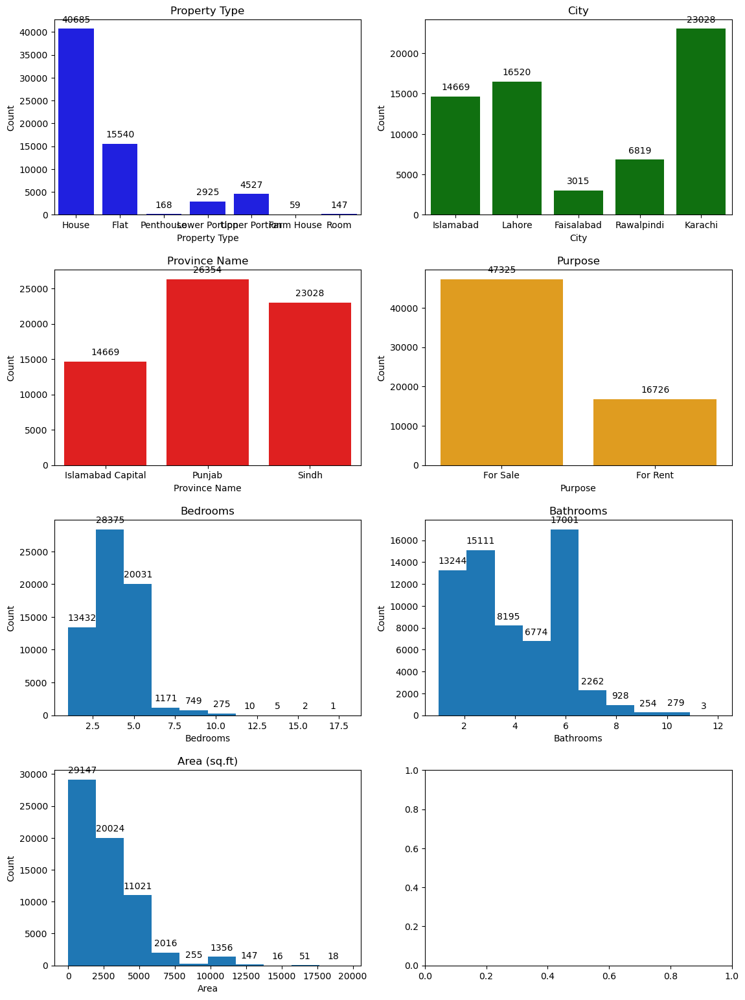

In [36]:
fig, axes = plt.subplots(4, 2, figsize=(12, 16))
plt.tight_layout(pad = 4)

sns.countplot(x='property_type', data=df, color='blue', ax=axes[0, 0])
axes[0, 0].set_title('Property Type')
axes[0, 0].set_xlabel('Property Type')
axes[0, 0].set_ylabel('Count')

sns.countplot(x='city', data=df, color='green', ax=axes[0, 1])
axes[0, 1].set_title('City')
axes[0, 1].set_xlabel('City')
axes[0, 1].set_ylabel('Count')

sns.countplot(x='province', data=df, color='red', ax=axes[1, 0])
axes[1, 0].set_title('Province Name')
axes[1, 0].set_xlabel('Province Name')
axes[1, 0].set_ylabel('Count')

sns.countplot(x='purpose', data=df, color='orange', ax=axes[1, 1])
axes[1, 1].set_title('Purpose')
axes[1, 1].set_xlabel('Purpose')
axes[1, 1].set_ylabel('Count')

axes[2, 0].hist(df['bedrooms'])
axes[2, 0].set_title('Bedrooms')
axes[2, 0].set_xlabel('Bedrooms')
axes[2, 0].set_ylabel('Count')

axes[2, 1].hist(df['baths'])
axes[2, 1].set_title('Bathrooms')
axes[2, 1].set_xlabel('Bathrooms')
axes[2, 1].set_ylabel('Count')

axes[3, 0].hist(df['area (sq.ft)'])
axes[3, 0].set_title('Area (sq.ft)')
axes[3, 0].set_xlabel('Area')
axes[3, 0].set_ylabel('Count')

for ax in axes.flatten():
    for p in ax.patches:
        ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

plt.show()

### Relationship of bathroom and bedrooms with price

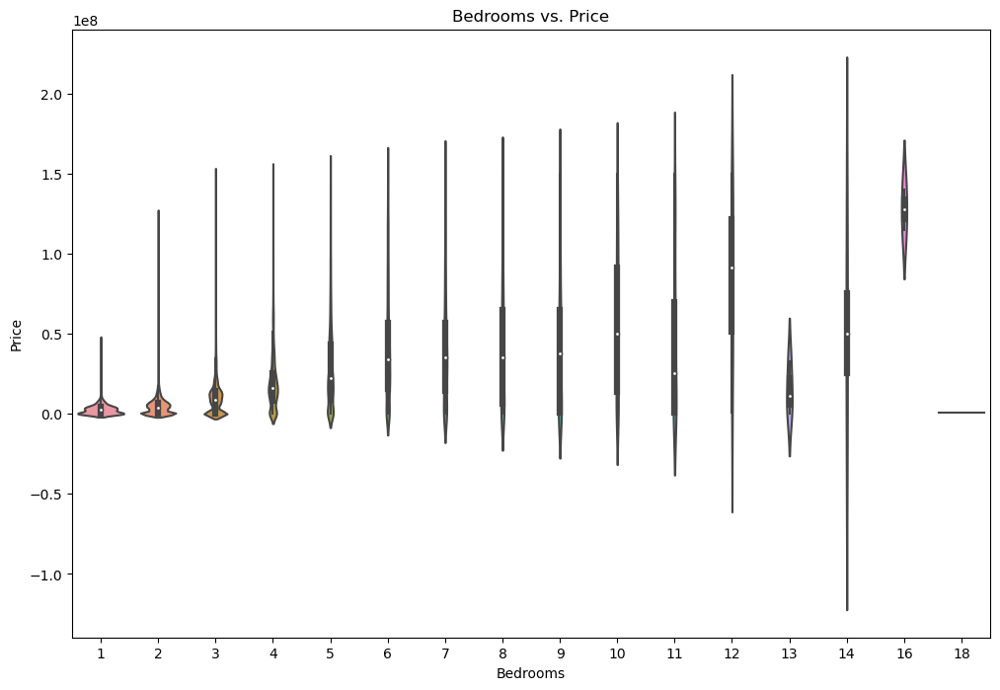

In [37]:
plt.figure(figsize = (12, 8))
sns.violinplot(data = df, x = 'bedrooms', y = 'price')
plt.title('Bedrooms vs. Price')
plt.xlabel('Bedrooms')
plt.ylabel('Price')
plt.show()

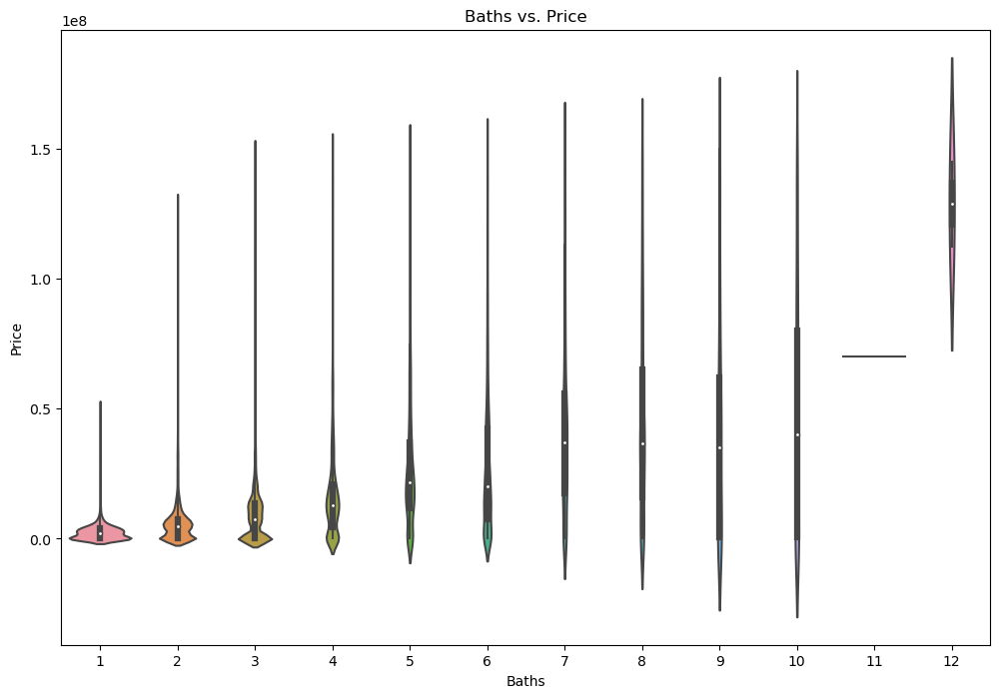

In [38]:
plt.figure(figsize = (12, 8))
sns.violinplot(data = df, x = 'baths', y = 'price')
plt.title('Baths vs. Price')
plt.xlabel('Baths')
plt.ylabel('Price')
plt.show()

### Distribution of the price

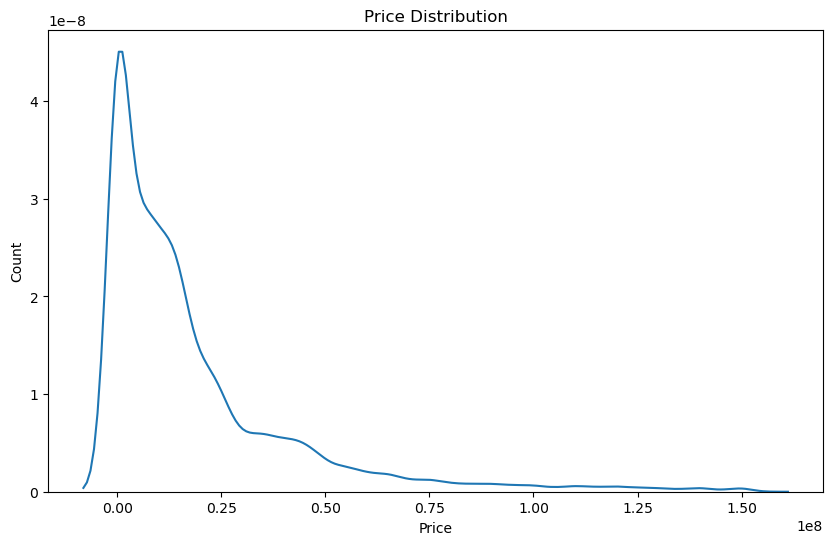

In [39]:
plt.figure(figsize=(10, 6))
sns.kdeplot(data = df, x = 'price')
plt.title('Price Distribution')
plt.xlabel('Price')
plt.ylabel('Count')
plt.show()

### Average price w.r.t each property type

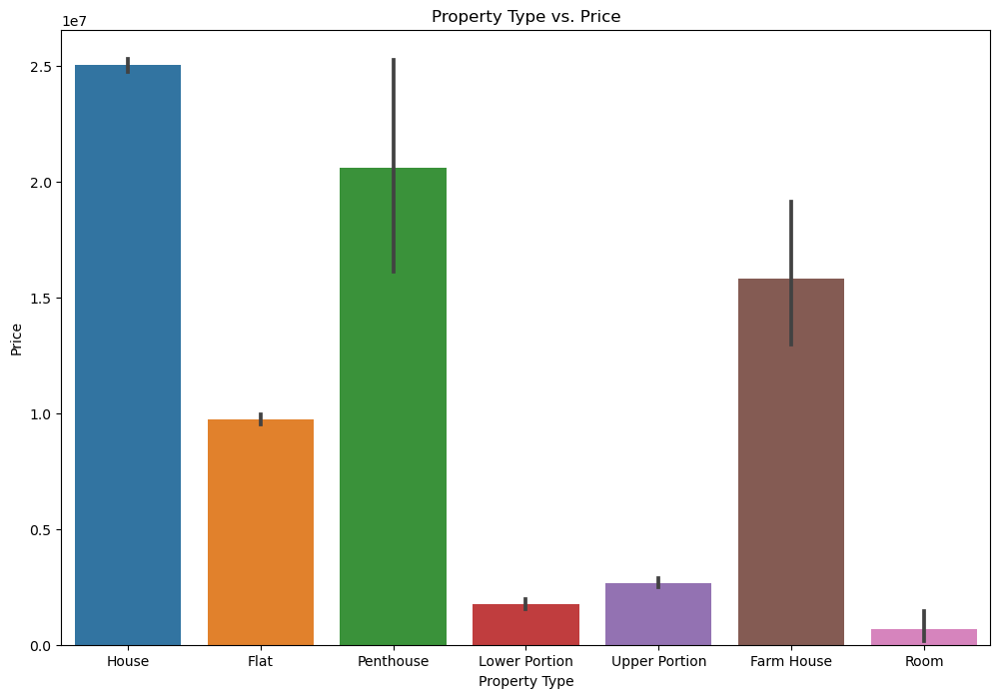

In [40]:
plt.figure(figsize = (12, 8))
sns.barplot(data = df, x = 'property_type', y = 'price')
plt.title('Property Type vs. Price')
plt.xlabel('Property Type')
plt.ylabel('Price')
plt.show()

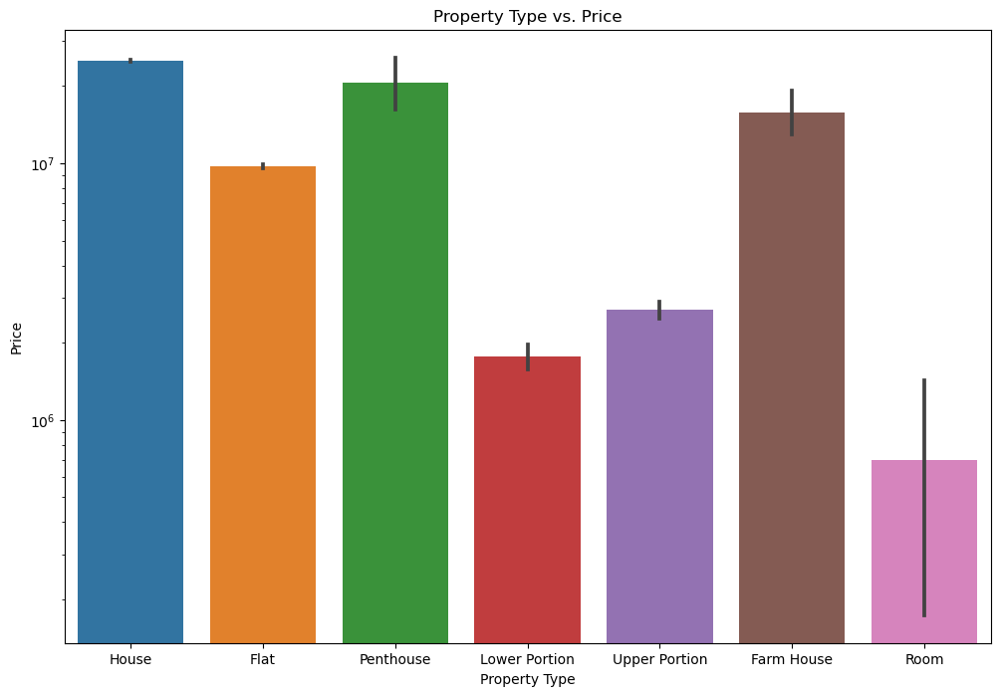

In [41]:
plt.figure(figsize = (12, 8))
sns.barplot(data = df, x = 'property_type', y = 'price')
plt.title('Property Type vs. Price')
plt.xlabel('Property Type')
plt.ylabel('Price')
plt.yscale('log')
plt.show()

### Counts of property types in each city

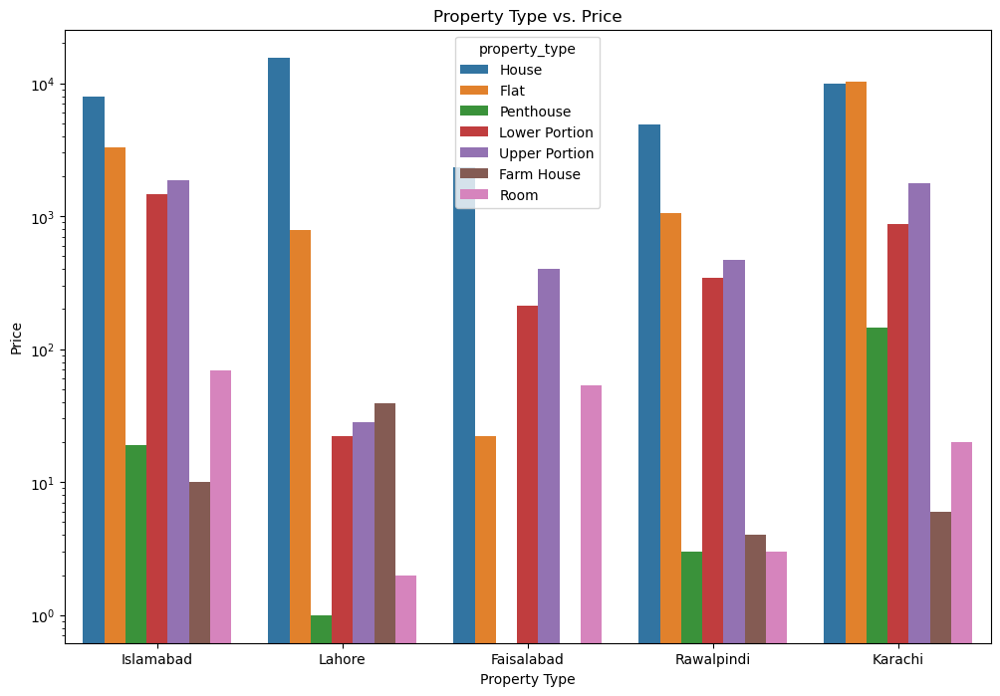

In [42]:
plt.figure(figsize = (12, 8))
sns.countplot(data = df, x = 'city', hue = 'property_type')
plt.title('Property Type vs. Price')
plt.xlabel('Property Type')
plt.ylabel('Price')
plt.yscale('log')
plt.show()

### Average price of each property types w.r.t city

<Figure size 1600x1000 with 0 Axes>

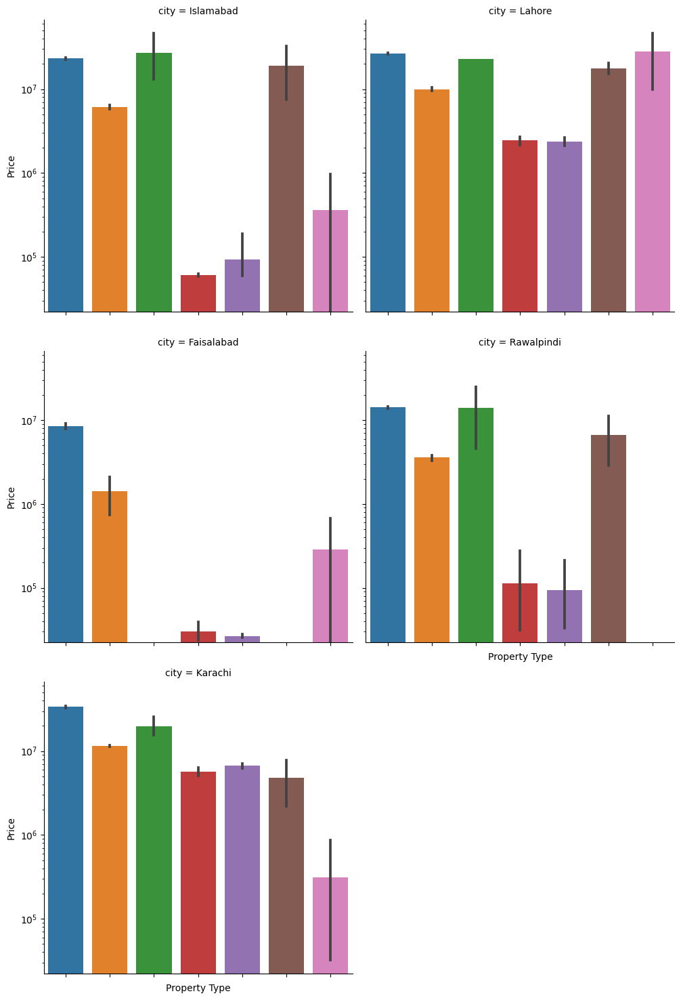

In [43]:
plt.figure(figsize=(16, 10))
plot = sns.catplot(kind='bar', x='property_type', y='price', data=df, col='city', col_wrap=2)

# Rotate x-axis tick labels and set y-scale 
for ax in plot.axes.flat:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')
    ax.set_yscale('log')


# Set xlabel and ylabel for each figure
for ax in plot.axes.flat:
    ax.set_xlabel('Property Type')
    ax.set_ylabel('Price')

plt.show()

### Average price within each province

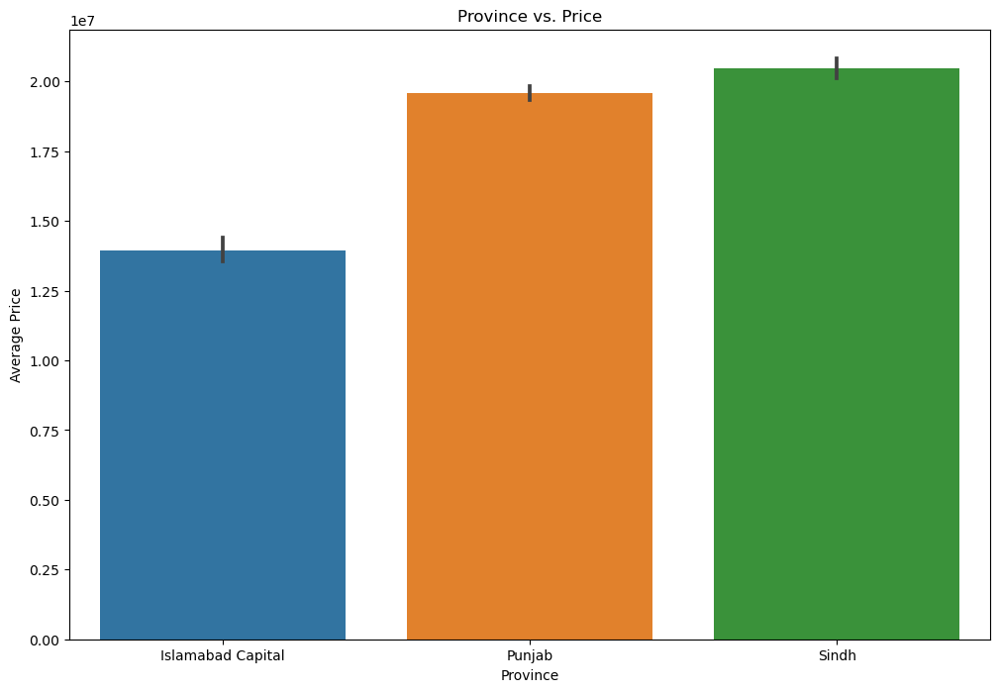

In [44]:
plt.figure(figsize=(12, 8))
sns.barplot(data = df, x = 'province', y = 'price')
plt.title('Province vs. Price')
plt.xlabel('Province')
plt.ylabel('Average Price')
plt.show()

Sindh has the highest average price amongst the other provinces.

### A Map visualization of price distribution

In [45]:
fig = px.scatter_mapbox(df, lat = 'latitude', lon = 'longitude', hover_name = 'province', 
                        hover_data = ['price', 'location'],
                        color = 'price', size = 'price', size_max = 15, zoom = 5, mapbox_style = 'open-street-map')

fig.update_layout(title = 'Property Price Distribution',
                  mapbox=dict(center=dict(lat=df['latitude'].mean(), lon=df['longitude'].mean())))

fig.show()


### Top 15 agencies with the most properties listed

In [46]:
# agency counts would show how many properties they have listed

agency_counts = df['agence'].value_counts().sort_values(ascending = False)
agency_counts

Chaudhry Estate                 261
Haram Estate & Builders         237
Harum Real Estate & Builders    226
Muzammil Associates             214
Azeem Estate Agency             195
                               ... 
Fauji Estate & Builders           1
Makki Real Estate                 1
Select Real Estate                1
Emirates Construction             1
Lasani Estate & Builders          1
Name: agence, Length: 5165, dtype: int64

In [47]:
# top 10 agencies
agency_counts[:15]

Chaudhry Estate                                   261
Haram Estate & Builders                           237
Harum Real Estate & Builders                      226
Muzammil Associates                               214
Azeem Estate Agency                               195
Al-Ghous Real Estate Management & Construction    180
Al Qasim Estate Agency                            178
Al Noor Estate Agency                             168
AARCO Fazaia Authorized Dealer                    162
New Hira Estate                                   161
Seven Eight Six Associates                        156
Real Investment Consultants                       155
Property Point                                    155
Secure Future Estate & Builder                    152
Leads Estates                                     151
Name: agence, dtype: int64

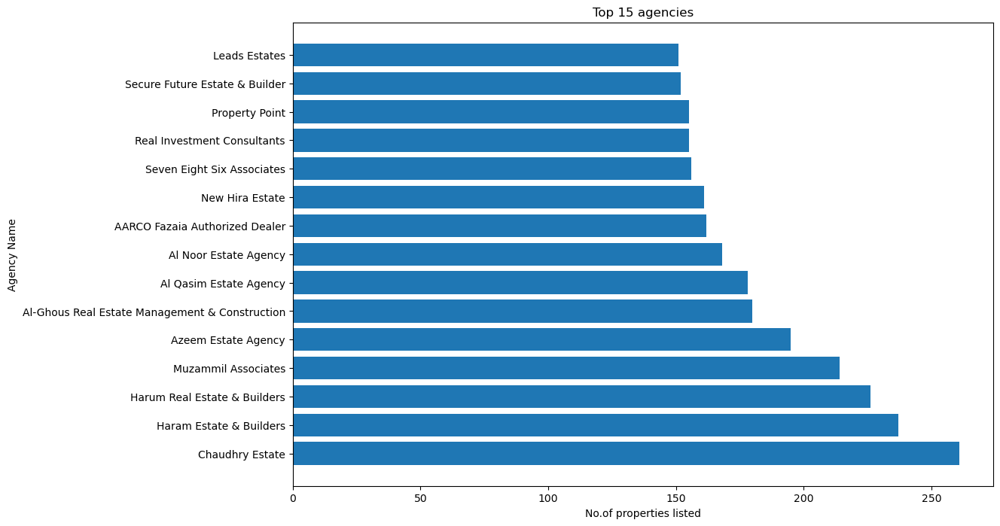

In [48]:
# bar chart of the top 15 agencies and their counts of properties

plt.figure(figsize = (12, 8))
plt.barh(agency_counts[:15].index, agency_counts[:15].values)
plt.title('Top 15 agencies')
plt.ylabel('Agency Name')
plt.xlabel('No.of properties listed')
plt.show()

### Top 15 agencies with the highest average prices


In [49]:
agency_price = df.groupby('agence')['price'].mean().sort_values(ascending = False)
agency_price

agence
Rahi Builders                         1.500000e+08
Estate Planners                       1.400000e+08
21st Century Estate & Construction    1.400000e+08
Rasheed Brothers                      1.400000e+08
Property Trade Centre                 1.300000e+08
                                          ...     
Mujahid Estate Property Advisor       1.500000e+04
Adeel Estate Agency                   1.446667e+04
Al Mubeen Estate                      1.440909e+04
Kohsar Real Estate                    1.250000e+04
Rehman Estate Advisor                 6.500000e+03
Name: price, Length: 5165, dtype: float64

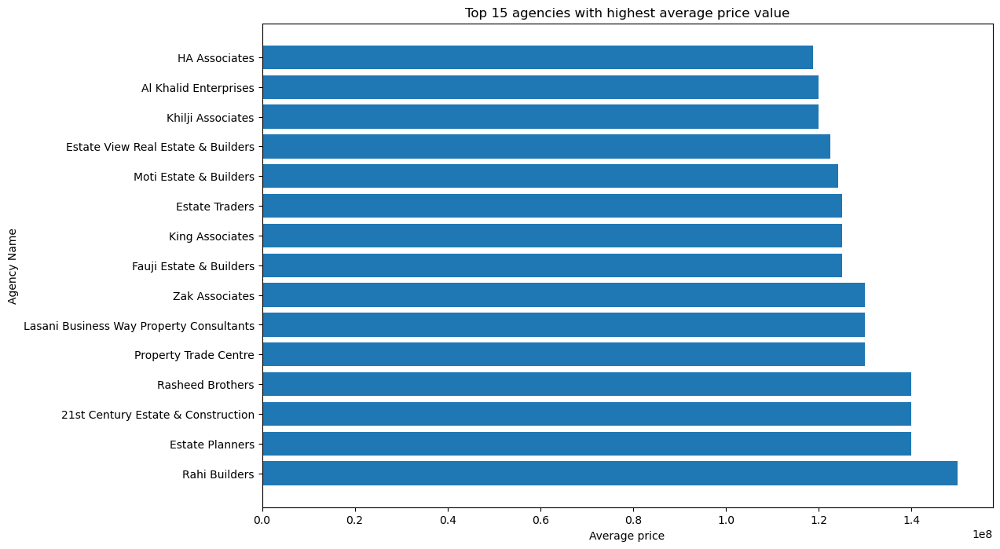

In [50]:
plt.figure(figsize = (12, 8))
plt.barh(agency_price[:15].index, agency_price[:15].values)
plt.title('Top 15 agencies with highest average price value')
plt.ylabel('Agency Name')
plt.xlabel('Average price')
plt.show()

The unsual high average price of few agencies is because they only has 1 listed property! It will be more insightful to visualize average price of the 15 agencies with the highest listed properties

In [52]:
agencies_to_extract = agency_counts[:15].index
prices_of_agencies = agency_price[agencies_to_extract].sort_values(ascending = False)
prices_of_agencies

Leads Estates                                     4.421921e+07
New Hira Estate                                   4.400683e+07
Harum Real Estate & Builders                      4.062345e+07
Haram Estate & Builders                           3.682700e+07
Secure Future Estate & Builder                    3.630724e+07
Al-Ghous Real Estate Management & Construction    3.274694e+07
Property Point                                    2.196351e+07
Muzammil Associates                               2.118303e+07
Seven Eight Six Associates                        1.858256e+07
Chaudhry Estate                                   1.814820e+07
Real Investment Consultants                       1.393613e+07
Azeem Estate Agency                               1.149295e+07
AARCO Fazaia Authorized Dealer                    8.220617e+06
Al Qasim Estate Agency                            7.590590e+05
Al Noor Estate Agency                             3.484583e+05
Name: price, dtype: float64

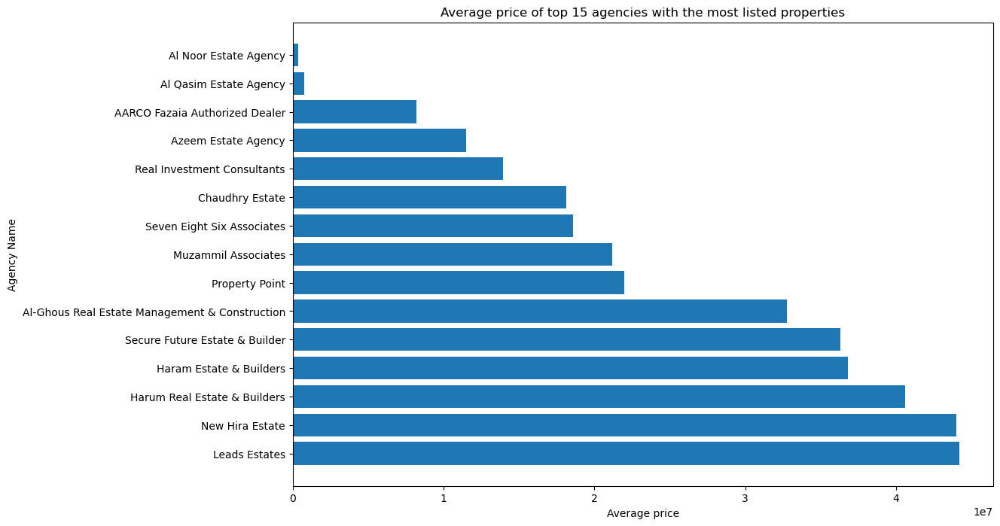

In [53]:
plt.figure(figsize = (12, 8))
plt.barh(prices_of_agencies.index, prices_of_agencies.values)
plt.title("Average price of top 15 agencies with the most listed properties")
plt.ylabel('Agency Name')
plt.xlabel('Average price')
plt.show()

### Time Series Analysis of Mean Price by City

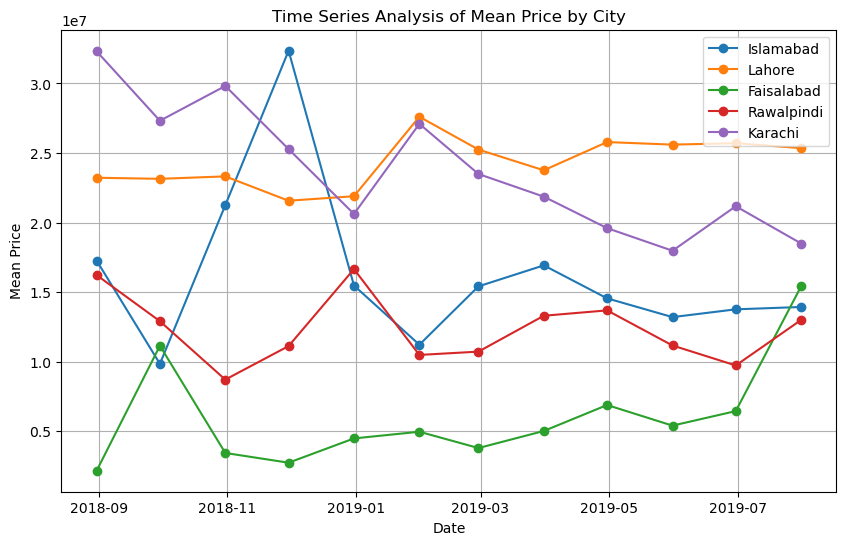

In [55]:
# Convert month, day, and year columns to datetime format
df['date'] = pd.to_datetime(df[['month', 'day', 'year']])

# Set the date column as the index
df.set_index('date', inplace=True)

# Resample the data by month and calculate the mean price
monthly_mean_price = df.groupby(['city', pd.Grouper(freq='M')])['price'].mean()

# Plot the time series analysis for each city
plt.figure(figsize=(10, 6))
for city in df['city'].unique():
    city_data = monthly_mean_price[city]
    plt.plot(city_data.index, city_data, marker='o', label=city)
plt.xlabel('Date')
plt.ylabel('Mean Price')
plt.title('Time Series Analysis of Mean Price by City')
plt.legend()
plt.grid(True)
plt.show()

In [56]:
df.reset_index(drop = True, inplace = True)
print(df.shape)
df.head()

(64051, 16)


,property_type,price,location,city,province,latitude,longitude,baths,purpose,bedrooms,agence,agent,area (sq.ft),month,day,year
0,House,7000000,DHA Defence,Islamabad,Islamabad Capital,33.492591,73.301339,3,For Sale,3,Easy Property,Muhammad Junaid Ceo Muhammad Shahid Director,2180.080,7,10,2019
1,House,50000000,DHA Defence,Islamabad,Islamabad Capital,33.540894,73.095732,7,For Sale,7,Easy Property,Muhammad Junaid Ceo Muhammad Shahid Director,5445.000,10,19,2018
2,House,19000000,DHA Defence,Islamabad,Islamabad Capital,33.508481,73.091826,3,For Sale,3,Infinity Properties,Ali,2725.100,6,20,2019
3,House,80000000,DHA Defence,Islamabad,Islamabad Capital,33.541728,73.094103,7,For Sale,7,Easy Property,Muhammad Junaid Ceo Muhammad Shahid Director,10890.000,7,16,2019
4,House,100000000,F-6,Islamabad,Islamabad Capital,33.724020,73.074524,5,For Sale,5,Property Syendicate,Rizwan Shafqat,4850.678,1,5,2019


# Model Training and Evaluation

## Preparing the data for model

### Dropping irrelevant attributes for model training

`province` column is a more general column which conveys more general information compared to `city` column. It can viewed as a column giving somewhat redundant and general information compared to the `city` column.

In [57]:
df.drop(columns = ['agence', 'agent', 'month', 'day', 'year', 'province'], inplace = True)
df.columns

Index(['property_type', 'price', 'location', 'city', 'latitude', 'longitude',
       'baths', 'purpose', 'bedrooms', 'area (sq.ft)'],
      dtype='object')

In [58]:
df.shape

(64051, 10)

### Reducing location values

We tried to decrease the number of locations in this column but every location was unique, hence making it impossible to merge and lessen the amount of unique values to deal with. 

This made it extremely hard to decide which encoding to use as one-hot encoding would increase the number of features to a large amount and label encoding would create unnecessary orders in the locations.

Also, the model performed a lot better without this column as this column is full of complexity and reduces the performance of the model.

In [59]:
city_locs = df.groupby('city')['location']
for i in city_locs:
    print(i)

('Faisalabad', 35              Satiana Road
599                 Manawala
762               Canal Park
884              Muslim Town
927             Eden Gardens
                ...         
64014          Kohinoor City
64015          Kohinoor City
64016          Kohinoor City
64033    Peoples Colony No 1
64047            Eden Valley
Name: location, Length: 3015, dtype: object)
('Islamabad', 0        DHA Defence
1        DHA Defence
2        DHA Defence
3        DHA Defence
4                F-6
            ...     
64045            G-9
64046            I-8
64048            F-8
64049            F-8
64050            G-9
Name: location, Length: 14669, dtype: object)
('Karachi', 55                DHA Defence
56                DHA Defence
57                  Scheme 33
58                      Malir
59                      Malir
                 ...         
64020             DHA Defence
64021             DHA Defence
64023               Scheme 33
64037    Gulshan-e-Iqbal Town
64042             

In [60]:
df['city'].unique()

array(['Islamabad', 'Lahore', 'Faisalabad', 'Rawalpindi', 'Karachi'],
      dtype=object)

In [61]:
khi = df[df['city'] == 'Karachi']['location'].unique()
print(len(khi))
print(khi)

135
['DHA Defence' 'Scheme 33' 'Malir' 'Falcon Complex Faisal'
 'Gulshan-e-Iqbal Town' 'Navy Housing Scheme Karsaz' 'Bahria Town Karachi'
 'Gulistan-e-Jauhar' 'Cantt' 'North Nazimabad' 'Northern Bypass'
 'Fazaia Housing Scheme' 'Shaheed Millat Road' 'Jamshed Town' 'Zamzama'
 'Bath Island' 'Clifton' 'Korangi' 'Defence View Society' 'North Karachi'
 'Naval Housing Scheme' 'Scheme 45' 'Kashmir Road'
 'Sindh Industrial Trading Estate (SITE)' 'Bin Qasim Town' 'Azam Town'
 'PAF Housing Scheme' 'Liaquatabad' 'Nazimabad' 'Gadap Town'
 'Federal B Area' 'Tariq Road' 'Amir Khusro' 'Al-Hilal Society'
 'New Karachi' 'Civil Lines' 'Naya Nazimabad' 'KDA Scheme 1'
 'Malir Housing Scheme 1' 'Naval Colony' 'Delhi Colony'
 'Muslimabad Society' 'P & T Colony' 'Shahra-e-Faisal' 'Super Highway'
 'Jinnah Avenue' 'Hill Park' 'Saadi Road' 'Shadman 2' 'Gulberg Town'
 'Aisha Manzil' 'Orangi Town' 'Shahra-e-Qaideen' 'Mehmoodabad'
 'DHA City Karachi' 'Teacher Society' 'Saddar Town' 'Hub River Road'
 'Manzoor Colon

In [62]:
# these are same values in the location column

# DHA Defence, Defence View Society, Khayaban-e-Ittehad Road
# Teacher Society, Teachers Society
# Gizri, Gizri Road
# Korangi Road, Korangi

In [63]:
# # replacing above values with a common name

# khi_index = df[df['city'] == 'Karachi'].index
# khi_index
# # df[df['city'] == 'Karachi']['location'] = df[df['city'] == 'Karachi']['location'].replace('Korangi Road', 'Korangi')
# df.loc[khi_index, 'location'] = 

In [64]:
lhe = df[df['city'] == 'Lahore']['location'].unique()
print(len(lhe))
print(lhe)

414
['Multan Road' 'Eden' 'Gulberg' 'EME Society' 'Izmir Town' 'Upper Mall'
 'Cavalry Ground' 'Bahria Town' 'Askari' 'Valencia Housing Society'
 'Paragon City' 'Architects Engineers Housing Society' 'DHA Defence'
 'Allama Iqbal Town' 'Cantt' 'Al Faisal Town'
 'T & T Aabpara Housing Society' 'Gulshan-e-Ravi' 'Canal Garden'
 'Tricon Village' 'PCSIR Housing Scheme' 'Model Town'
 'Pak Arab Housing Society' 'Wapda Town' 'State Life Housing Society'
 'Wahdat Road' 'Cricketer Villas' 'Rehman Villas' 'Garden Town'
 'Alfalah Town' 'Punjab Govt Employees Society' 'Garrison Homes'
 'Iqbal Park' 'Al Hamra Town' 'Al-Kabir Town' 'Divine Gardens'
 'Johar Town' 'Harbanspura' 'Green Town' 'New Super Town'
 'Beacon House Society' 'Manawan' 'Baghbanpura' 'Shalimar Town'
 'Sabzazar Scheme' 'Rana Town' 'Military Accounts Housing Society'
 'Lahore Canal Bank Cooperative Housing Society'
 'Punjab Govt Servant Society' 'Al-Kareem Premier Housing Scheme'
 'Zaitoon - New Lahore City' 'DHA 11 Rahbar' 'Omega Home

In [65]:
isl = df[df['city'] == 'Islamabad']['location'].unique()
print(len(isl))
print(isl)

145
['DHA Defence' 'F-6' 'F-7' 'F-17' 'Korang Town' 'Bahria Town' 'F-11'
 'F-10' 'E-11' 'G-13' 'G-11' 'Kuri Road' 'Bani Gala' 'F-8' 'I-8' 'G-9'
 'E-14' 'G-8' 'I-14' 'Pir Sohawa' 'Ghauri Town' 'G-15' 'Soan Garden'
 'G-12' 'Koral Town' 'PWD Housing Scheme' 'G-10' 'CBR Town'
 'Islamabad - Murree Expressway' 'H-13' 'B-17' 'Thanda Pani' 'D-12'
 'Bhara kahu' 'E-18' 'Pakistan Town' 'G-14'
 'National Police Foundation O-9' 'National Police Foundation' 'I-10'
 'Emaar Canyon Views' 'F-15' 'Simly Dam Road' 'E-7' 'Shah Allah Ditta'
 'Burma Town' 'Park Road' 'Spring Valley' 'Kashmir Highway'
 'Naval Anchorage' 'Multi Residencia & Orchards' 'FECHS' 'Abdullah Garden'
 'G-6' 'Green Avenue' 'Motorway Chowk' 'Mumtaz City' 'Chatha Bakhtawar'
 'Park Enclave' 'D-17' 'Margalla Town' 'I-13' 'Chak Shahzad' 'Swan Garden'
 'Rawal Enclave' 'I-9' 'Faisal Town - F-18' 'Shehzad Town' '9th Avenue'
 'Zaraj Housing Scheme' 'Park View City' 'Gulberg' 'Garden Town'
 'Alipur Farash' 'C-18' 'H-9' 'City Garden' 'Arsalan To

In [66]:
fsl = df[df['city'] == 'Faisalabad']['location'].unique()
print(len(fsl))
print(fsl)

147
['Satiana Road' 'Manawala' 'Canal Park' 'Muslim Town' 'Eden Gardens'
 'Canal Road' 'Jhang Road' 'Gulfishan Colony' 'Four Season Housing'
 'Samundari Road' 'Valencia Gardens' 'Daniyal Town' 'Wapda City'
 'Madina Town' 'Nisar Colony' 'Ghalib City' 'Imran Road'
 'Khayaban Gardens' 'Sheikh Colony' 'Citi Housing Society' 'Ahmadabad'
 'Eden Orchard' 'Eden Valley' 'Mansoorabad' 'Susan Road' 'Al Noor Garden'
 'Saeed Colony' 'Faisal Town' 'Sitara Valley' 'Khayaban Colony'
 'Green Town' 'Lasani Garden' 'Jaranwala Road'
 'Punjab Govt. Servants Housing Foundation' 'Rabbani Colony'
 'Johar Colony' 'Peoples Colony No 2' 'Officers Colony' 'Al Najaf Colony'
 'Peoples Colony No 1' 'Zia Colony' 'Sargodha Road' 'Samanabad'
 'Mediacom Avenue' 'Sir Syed Town' 'Others' 'D Ground'
 'Allama Iqbal Colony' 'Amin Town' 'Gulistan Colony No 1' 'Hassan Villas'
 'Khayaban Colony 2' 'Rasool Park' 'Makkah Garden' 'New Garden Town'
 'Punjab Small Industries Estate' 'Kohinoor Town' 'Kehkishan Colony No 2'
 'Millat R

In [67]:
rwl = df[df['city'] == 'Rawalpindi']['location'].unique()
print(len(rwl))
print(rwl)

179
['Media Town' 'Bahria Town Rawalpindi' 'Judicial Colony' 'Chaklala Scheme'
 'Gulraiz Housing Scheme' 'Askari 14' 'Askari 13' 'Askari 7' 'Askari 11'
 'Satellite Town' 'Affandi Colony' 'Askari 10' 'Misryal Road'
 'Adiala Road' 'Chakri Road' 'Liaquat Colony' 'Range Road' 'Chakra'
 'Quaid-e-Azam Colony' 'Defence Road' 'Dhoke Gangal' 'Girja Road'
 'Gulistan Colony' 'Police Foundation Housing Scheme' 'Gulshan-e-Saeed'
 'Lalazar' 'DAV College Road' 'Askari 12' 'Peshawar Road' 'Walait Homes'
 'Gulshan Abad' 'Peer Meher Ali Shah Town' 'Fazaia Colony'
 'Air Force Housing Society' 'Nawaz Colony' 'Bakra Mandi' 'Ghaziabad'
 'Bahar Colony' 'Lalarukh Colony' 'Airport Housing Society' 'Sadiqabad'
 'Janjua Town' 'Shalley Valley' 'Farooq-e-Azam Road' 'Khurram Colony'
 'Eastridge Housing Scheme' 'Civil Lines' 'Tulsa Road' 'Kartar Pura'
 'Afshan Colony' 'Mohan Pura' 'Westridge' 'Allama Iqbal Colony'
 'Taj Residencia' 'Jhanda Chichi' 'Bostan Valley' 'High Court Road'
 'Sher Zaman Colony' 'Gulzar-e-Quai

### Encoding the categorical features

In [68]:
# label encoding for the location column
le = LabelEncoder()
df['location_encoded'] = le.fit_transform(df['location'])
df.head()

,property_type,price,location,city,latitude,longitude,baths,purpose,bedrooms,area (sq.ft),location_encoded
0,House,7000000,DHA Defence,Islamabad,33.492591,73.301339,3,For Sale,3,2180.080,222
1,House,50000000,DHA Defence,Islamabad,33.540894,73.095732,7,For Sale,7,5445.000,222
2,House,19000000,DHA Defence,Islamabad,33.508481,73.091826,3,For Sale,3,2725.100,222
3,House,80000000,DHA Defence,Islamabad,33.541728,73.094103,7,For Sale,7,10890.000,222
4,House,100000000,F-6,Islamabad,33.724020,73.074524,5,For Sale,5,4850.678,291


In [69]:
# One-Hot Encoding for the rest of categorical features
categorical_features = ['property_type', 'city', 'purpose']
df = pd.get_dummies(df, columns = categorical_features)
df.head()

,price,location,latitude,longitude,baths,bedrooms,area (sq.ft),location_encoded,property_type_Farm House,property_type_Flat,...,property_type_Penthouse,property_type_Room,property_type_Upper Portion,city_Faisalabad,city_Islamabad,city_Karachi,city_Lahore,city_Rawalpindi,purpose_For Rent,purpose_For Sale
0,7000000,DHA Defence,33.492591,73.301339,3,3,2180.080,222,0,0,...,0,0,0,0,1,0,0,0,0,1
1,50000000,DHA Defence,33.540894,73.095732,7,7,5445.000,222,0,0,...,0,0,0,0,1,0,0,0,0,1
2,19000000,DHA Defence,33.508481,73.091826,3,3,2725.100,222,0,0,...,0,0,0,0,1,0,0,0,0,1
3,80000000,DHA Defence,33.541728,73.094103,7,7,10890.000,222,0,0,...,0,0,0,0,1,0,0,0,0,1
4,100000000,F-6,33.724020,73.074524,5,5,4850.678,291,0,0,...,0,0,0,0,1,0,0,0,0,1


In [70]:
df.sample(5)

,price,location,latitude,longitude,baths,bedrooms,area (sq.ft),location_encoded,property_type_Farm House,property_type_Flat,...,property_type_Penthouse,property_type_Room,property_type_Upper Portion,city_Faisalabad,city_Islamabad,city_Karachi,city_Lahore,city_Rawalpindi,purpose_For Rent,purpose_For Sale
30144,22500000,Gulshan-e-Iqbal Town,24.911726,67.098014,6,3,1308.048,388,0,0,...,0,0,0,0,0,1,0,0,0,1
29139,35000,G-8,33.697423,73.049555,2,2,1362.550,324,0,0,...,0,0,0,0,1,0,0,0,1,0
5169,9800000,Airport Housing Society,33.590885,73.133530,4,4,1635.060,32,0,0,...,0,0,0,0,0,0,0,1,0,1
10592,14500000,G-13,33.645957,72.962472,6,5,1090.040,317,0,0,...,0,0,0,0,1,0,0,0,0,1
19957,48000000,Gulberg,31.495909,74.350569,6,5,5445.000,364,0,0,...,0,0,0,0,0,0,1,0,0,1


### Splitting dataset into input and output variables

We also tried to do modeling using the `location` column but it was an obstacle as it was deproving the model's performance to great extents. The model showed a lot better performance with this column dropped.

We also tried to decrease the number of locations in this column but every location was unique, hence making it impossible to merge and lessen the amount of unique values to deal with. It made the model complext which was forcing us to increase the number of iterations but those reached to their maximum too.

It was hence decided that the model performed better without having this column as a input in training.

In [71]:
X = df.drop(['price', 'location', 'location_encoded'], axis=1)
y = df['price']
X

,latitude,longitude,baths,bedrooms,area (sq.ft),property_type_Farm House,property_type_Flat,property_type_House,property_type_Lower Portion,property_type_Penthouse,property_type_Room,property_type_Upper Portion,city_Faisalabad,city_Islamabad,city_Karachi,city_Lahore,city_Rawalpindi,purpose_For Rent,purpose_For Sale
0,33.492591,73.301339,3,3,2180.080,0,0,1,0,0,0,0,0,1,0,0,0,0,1
1,33.540894,73.095732,7,7,5445.000,0,0,1,0,0,0,0,0,1,0,0,0,0,1
2,33.508481,73.091826,3,3,2725.100,0,0,1,0,0,0,0,0,1,0,0,0,0,1
3,33.541728,73.094103,7,7,10890.000,0,0,1,0,0,0,0,0,1,0,0,0,0,1
4,33.724020,73.074524,5,5,4850.678,0,0,1,0,0,0,0,0,1,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64046,33.673783,73.074703,1,1,517.769,0,0,0,0,0,1,0,0,1,0,0,0,1,0
64047,31.436061,73.154585,1,1,1580.558,0,0,0,0,0,1,0,1,0,0,0,0,1,0
64048,33.713131,73.038383,1,1,5445.000,0,0,0,0,0,1,0,0,1,0,0,0,1,0
64049,33.713131,73.038383,1,1,5445.000,0,0,0,0,0,1,0,0,1,0,0,0,1,0


### Splitting data into training and testing sets

In [72]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

### Scaling the numerical features

In [73]:
# Scale the numerical features
scaler = MinMaxScaler()
numerical_features = ['latitude', 'longitude', 'area (sq.ft)']

X_train[numerical_features] = scaler.fit_transform(X_train[numerical_features])
X_test[numerical_features] = scaler.transform(X_test[numerical_features])

X_train

,latitude,longitude,baths,bedrooms,area (sq.ft),property_type_Farm House,property_type_Flat,property_type_House,property_type_Lower Portion,property_type_Penthouse,property_type_Room,property_type_Upper Portion,city_Faisalabad,city_Islamabad,city_Karachi,city_Lahore,city_Rawalpindi,purpose_For Rent,purpose_For Sale
45596,0.003351,0.030693,3,3,0.080632,0,1,0,0,0,0,0,0,0,1,0,0,0,1
17160,0.184622,0.804367,8,8,0.555556,0,0,1,0,0,0,0,0,1,0,0,0,0,1
38266,0.139416,0.989033,6,4,0.139022,0,0,1,0,0,0,0,0,0,0,1,0,0,1
7621,0.183131,0.820067,3,3,0.069511,0,0,1,0,0,0,0,0,1,0,0,0,0,1
27993,0.185218,0.811054,6,6,0.361111,0,0,1,0,0,0,0,0,1,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62570,0.138031,0.820576,3,3,0.277778,0,0,0,0,0,0,1,1,0,0,0,0,1,0
38158,0.138115,0.987539,5,4,0.139022,0,0,1,0,0,0,0,0,0,0,1,0,0,1
860,0.003845,0.024538,6,7,0.129290,0,0,1,0,0,0,0,0,0,1,0,0,0,1
15795,0.001561,0.021992,8,8,0.250239,0,0,1,0,0,0,0,0,0,1,0,0,1,0


In [75]:
X_train.shape

(51240, 19)

In [76]:
X_test.shape

(12811, 19)

## Training, Tuning and Evaluation

### Training the model

An MPL model is selected as such models are relevantly easier to less complex and works well with non-sequential datasets i.e., the dataset is not of time series and each sample and observation can be considered as an independent training example

In [77]:
model = MLPRegressor(hidden_layer_sizes = (300, 300), 
                     random_state = 42, 
                     max_iter = 1000, 
                     activation = 'relu')
fitting = model.fit(X_train, y_train)

D:\Anaconda\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:684: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.



#### Predictions and evaluation

In [85]:
# Make predictions on the test set
y_pred_final = model.predict(X_test)

In [92]:
# Evaluate the model's performance
mse = mean_squared_error(y_test, y_pred_final)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred_final)
r2 = r2_score(y_test, y_pred_final)

print("Mean Squared Error:", mse)
print("Root Mean Squared Error:", rmse)
print("Mean Absolute Error:", mae)
print(f"R-squared (accuarcy): {round(r2*100, 3)} %")

Mean Squared Error: 117673399338033.88
Root Mean Squared Error: 10847737.060697677
Mean Absolute Error: 5432323.919587065
R-squared (accuarcy): 80.604 %


#### Graph for loss vs iterations

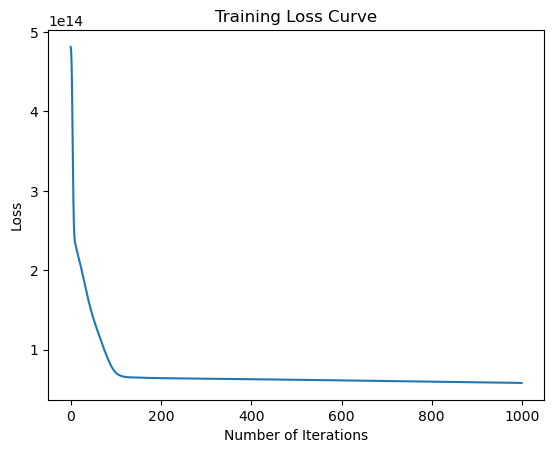

In [93]:
# Plot the training loss
plt.plot(fitting.loss_curve_)
plt.title("Training Loss Curve")
plt.xlabel("Number of Iterations")
plt.ylabel("Loss")
plt.show()

## Hyperparameter tuning 

This would have been the next step in the modeling part where the model performance would have been tried to increased by performing hyperparameter tuning i.e., selecing the optimal and best values for model's parameters. But due to shortage and long waiting time for the training and cross-valdiation, this code is commented out.

In [ ]:
# # Define the parameter grid for hyperparameter tuning
# param_grid = {
#     'hidden_layer_sizes': [(100, 100), (300, 300), (300, 300, 300)],
#     'alpha':[0.0001, 0.001, 0.01],
#     'learning_rate_init': [0.001, 0.01, 0.1],
#     'learning_rate': ['constant', 'adaptive'],
#     'max_iter': [250, 500, 1000]
# }

# # Create the MLPRegressor model
# model = MLPRegressor(random_state = 42, activation = 'relu')

# # Define the scoring metric
# scoring = {'MSE': make_scorer(mean_squared_error)}

# # Perform RandomizedSearchCV for hyperparameter tuning
# random_search = RandomizedSearchCV(model, param_grid, scoring = scoring, refit = 'MSE', cv = 5)
# random_search.fit(X_train, y_train)

In [ ]:
# # Print the best hyperparameters
# print("Best Hyperparameters:", grid_search.best_params_)

# # Make predictions on the test set using the best model
# best_model = random_search.best_estimator_
# y_pred = best_model.predict(X_test)

In [ ]:
# # Evaluate the best model's performance
# mse = mean_squared_error(y_test, y_pred)
# rmse = np.sqrt(mse)
# mae = mean_absolute_error(y_test, y_pred)
# r2 = r2_score(y_test, y_pred)

# print("Mean Squared Error:", mse)
# print("Root Mean Squared Error:", rmse)
# print("Mean Absolute Error:", mae)
# print("R-squared:", r2)

In [ ]:
# # Access the loss values during cross-validation
# cv_results = random_search.cv_results_
# mean_train_scores = cv_results['mean_train_MSE']
# mean_test_scores = cv_results['mean_test_MSE']
# param_combinations = cv_results['params']

# # Plot the loss graph
# plt.figure(figsize = (12, 8))
# plt.plot(range(len(param_combinations)), mean_train_scores, label = 'Mean Train MSE')
# plt.plot(range(len(param_combinations)), mean_test_scores, label = 'Mean Test MSE')
# plt.xticks(range(len(param_combinations)), [str(params) for params in param_combinations], rotation = 'vertical')
# plt.xlabel('Hyperparameter Combinations')
# plt.ylabel('MSE')
# plt.title('Cross-Validation Loss')
# plt.legend()
# plt.tight_layout()
# plt.show()

## Final CSV Test Predictions File

During imputation of the missing values in the dataset, a technique was used where each `baths` and `bedrooms` imputation was done based on the `property_type` it belonged to because it makes that a `house` would have a different number of `baths` and `bedrooms` compared to a `flat` or some other property.

This caused the indexes of the dataset to be reset as the imputed data had to be merged into one dataframe.
That is, the indexes would not match the `ID` column of the original dataset but it does not matter as `X_test` has unique indexes obviously.

In [94]:
y_pred_final

array([9.13161869e+06, 3.83203827e+07, 8.09495154e+06, ...,
       4.89507483e+04, 2.57362807e+04, 1.05374382e+07])

In [95]:
X_test

,latitude,longitude,baths,bedrooms,area (sq.ft),property_type_Farm House,property_type_Flat,property_type_House,property_type_Lower Portion,property_type_Penthouse,property_type_Room,property_type_Upper Portion,city_Faisalabad,city_Islamabad,city_Karachi,city_Lahore,city_Rawalpindi,purpose_For Rent,purpose_For Sale
52557,0.005362,0.025589,2,2,0.068121,0,1,0,0,0,0,0,0,0,1,0,0,0,1
144,0.181884,0.819194,7,6,0.277778,0,0,1,0,0,0,0,0,0,0,0,1,0,1
53724,0.002987,0.021486,2,2,0.058389,0,1,0,0,0,0,0,0,0,1,0,0,0,1
37417,0.135614,0.963191,4,4,0.277778,0,0,1,0,0,0,0,0,0,0,1,0,0,1
21768,0.180370,0.814647,7,5,0.139022,0,0,1,0,0,0,0,0,0,0,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20920,0.180696,0.817890,2,2,0.069511,0,0,1,0,0,0,0,0,0,0,0,1,0,1
39016,0.137973,0.980345,3,3,0.041706,0,0,1,0,0,0,0,0,0,0,1,0,0,1
18068,0.185068,0.808682,6,5,0.277778,0,0,1,0,0,0,0,0,1,0,0,0,1,0
56619,0.184229,0.817574,2,2,0.083413,0,0,0,1,0,0,0,0,1,0,0,0,1,0


In [96]:
indexes_test = X_test.index
predictions = y_pred_final

In [104]:
test_pred_df = pd.DataFrame({"predictons": predictions}, index = indexes_test)
test_pred_df

,predictons
X_test index,
52557,9.131619e+06
144,3.832038e+07
53724,8.094952e+06
37417,4.093165e+07
21768,1.966351e+07
...,...
20920,4.890765e+06
39016,6.984403e+06
18068,4.895075e+04


In [105]:
test_pred_df.index.name = "X_test index"

In [106]:
test_pred_df

,predictons
X_test index,
52557,9.131619e+06
144,3.832038e+07
53724,8.094952e+06
37417,4.093165e+07
21768,1.966351e+07
...,...
20920,4.890765e+06
39016,6.984403e+06
18068,4.895075e+04


In [107]:
test_pred_df.shape

(12811, 1)

In [110]:
test_pred_df.to_csv("Test(Radical Ravens).csv")